## 1. Визуализация графика обучения

In [1]:
import os
import numpy as np

Загрузим лоссы на трейне и валидации за все время обучения

In [2]:
epoch_starts = []
stage_ends = []
cur_pos = 0
for i in range(4):
    # read validation loss on stage
    val_loss = np.loadtxt('part{}/val_losses.txt'.format(i + 1))
    if i == 0:
        val_losses = val_loss
    else:
        val_losses = np.concatenate([val_losses, val_loss])
        
    # read training loss for all epochs
    n_epochs = len(val_loss)
    for epoch in range(n_epochs):
        epoch_loss = np.loadtxt('part{}/losses_on_epoch{}.txt'.format(i + 1, epoch + 1))
        if i == 0 and epoch == 0:
            train_losses = epoch_loss
        else:
            train_losses = np.concatenate([train_losses, epoch_loss])
        cur_pos += len(epoch_loss)
        epoch_starts.append(cur_pos)
    stage_ends.append(cur_pos)

In [3]:
import matplotlib.pyplot as plt
%matplotlib inline

In [4]:
def running_mean(x, n):
    cumsum = np.cumsum(x)
    return (cumsum[n:] - cumsum[:-n]) / n

Text(0, 0.5, 'MSE')

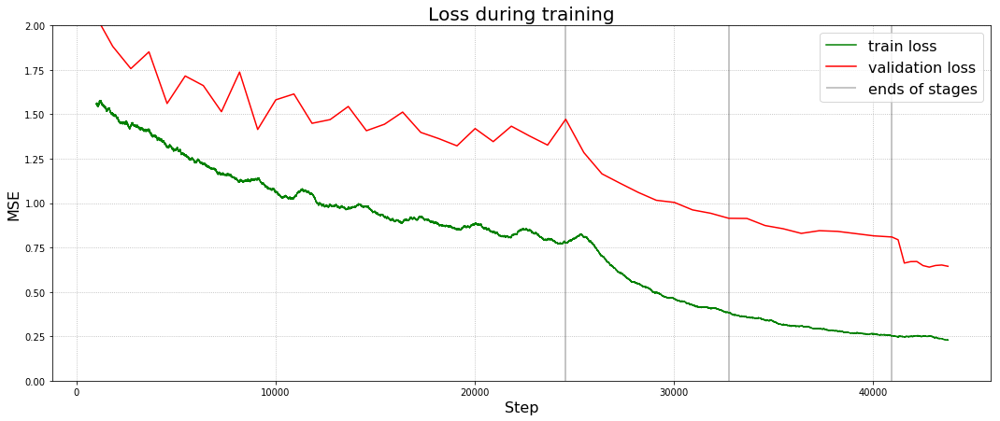

In [6]:
ylim = 2
plt.figure(figsize=(18, 7))
plt.title('Loss during training', fontsize=20)
plt.grid(ls=':')
plt.plot(np.arange(1000, len(train_losses)), running_mean(train_losses, 1000), color='g', label='train loss')
plt.plot(epoch_starts, val_losses, color='r', label='validation loss')
plt.ylim((0, ylim))
for i in range(3):
    if i == 0:
        plt.vlines(stage_ends[i], 0, ylim, alpha=0.3, label='ends of stages')
    else:
        plt.vlines(stage_ends[i], 0, ylim, alpha=0.3)
plt.legend(fontsize=16)
plt.xlabel('Step', fontsize=16)
plt.ylabel('MSE', fontsize=16)

## Визуализация работы нейросети

In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

In [2]:
import h5py
train_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/train_data_halfsize_small.hdf5', 'r')
rgbs_train = train_data_file['data']
depths_train = train_data_file['label']
val_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_scenes_halfsize.hdf5', 'r')
rgbs_val = val_data_file['data']
depths_val = val_data_file['label']
test_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_collections.hdf5', 'r')
rgbs_test = test_data_file['data']
depths_test = test_data_file['label']

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
from keras.models import load_model
model = load_model('part4/model_after_stage_0.hdf5')

Using TensorFlow backend.


### Обучающая выборка

In [9]:
rgbs_train_sample = np.array(rgbs_train[::1000])
depths_train_sample = np.array(depths_train[::1000])

In [11]:
train_prediction = model.predict(rgbs_train_sample, batch_size=32)

In [12]:
print('train MSE:', np.mean((train_prediction - depths_train_sample) ** 2))

train MSE: 0.23838745818527662


In [13]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

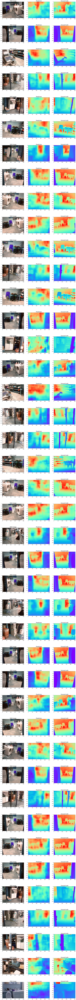

In [14]:
n = len(rgbs_train_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_train_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_train_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(train_prediction[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_train_sample[i] / 10, cmap='rainbow')

### Валидационная выборка: те же коллекции, другие сцены

In [15]:
rgbs_val_sample = np.array(rgbs_val[::534])
depths_val_sample = np.array(depths_val[::534])

In [16]:
val_prediction = model.predict(rgbs_val_sample, batch_size=32)

In [17]:
print('validation MSE:', np.mean((val_prediction - depths_val_sample) ** 2))

validation MSE: 0.7306356900629073


In [18]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

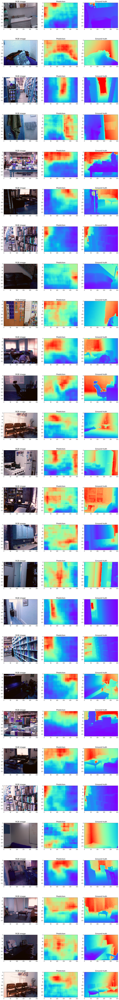

In [19]:
n = len(rgbs_val_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_val_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_val_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(val_prediction[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_val_sample[i] / 10, cmap='rainbow')

### Валидационная выборка: другие коллекции

In [ ]:
rgbs_test_sample = np.array(rgbs_test[::100])
depths_test_sample = np.array(depths_test[::100])

In [ ]:
def downscale(imgs):
    return 0.25 * (imgs[:, ::2, ::2, ...] + \
                   imgs[:, 1::2, ::2, ...] + \
                   imgs[:, ::2, 1::2, ...] + \
                   imgs[:, 1::2, 1::2, ...]
                  )

In [ ]:
rgbs_test_sample = downscale(rgbs_test_sample)
depths_test_sample = downscale(depths_test_sample)

In [ ]:
test_prediction = model.predict(rgbs_test_sample, batch_size=32)

In [ ]:
print('second-validation MSE:', np.mean((test_prediction - depths_test_sample) ** 2))

In [ ]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

In [ ]:
n = len(rgbs_test_sample)
plt.figure(figsize=(18, n * 6))
for i in range(len(rgbs_test_sample)):
    plt.subplot(n, 3, i * 3 + 1)
    plt.title('RGB image', fontsize=16)
    plt.imshow(unpreprocess(rgbs_test_sample[i]))
    plt.subplot(n, 3, i * 3 + 2)
    plt.title('Prediction', fontsize=16)
    plt.imshow(test_prediction[i] / 10, cmap='rainbow')
    plt.subplot(n, 3, i * 3 + 3)
    plt.title('Ground truth', fontsize=16)
    plt.imshow(depths_test_sample[i] / 10, cmap='rainbow')